# Anomaly detection for extremely rare events: Fraud detection in financial transactions

The case study chosen aims at demonstrating how to develop machine learning tools for anomaly detection for extremely rare events. The dataset used is (NTNU, 2017).

The scenario supposes a consultant who is employed to develop a model for automatic anomaly detection.


In [1]:
%run -i start_spark.py --master local[2] --driver-memory 4g
#%run -i start_spark.py --master spark://192.168.0.100:7077 --driver-memory 8g

Creating SparkContext...
SparkContext created.
Master URL: local[2]


**Do not forget to close the session with spark.stop()**

In [2]:
%matplotlib inline

from IPython.display import display, HTML
from pyspark import SparkFiles
from pyspark.ml.feature import StringIndexer
from pyspark.ml import Pipeline
from pyspark.sql.types import *
from pyspark.sql.window import Window
from pyspark.sql.functions import udf, substring, count

import seaborn as sns

import coursera_common as cc

import cufflinks as cf
import plotly.offline

cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

## Build an RDD and a Spark SQL View to simplify the data exploration

Data source for model development and testing use payments DB in CSV format. According to (NTNU, 2017) the data has the following structure:

<ol>
 <li>step - maps a unit of time in the real world. In this case 1 step is 1 hour of time. Total steps 744 (30 days simulation).</li>
 <li>type - CASH-IN, CASH-OUT, DEBIT, PAYMENT and TRANSFER.</li>
 <li>amount - amount of the transaction in local currency.</li>
 <li>nameOrig - customer who started the transaction</li>
 <li>oldbalanceOrg - initial balance before the transaction</li>
 <li>newbalanceOrig - new balance after the transaction</li>
 <li>nameDest - customer who is the recipient of the transaction</li>
 <li>oldbalanceDest - initial balance recipient before the transaction. Note that there is not information for customers that start with M (Merchants).</li>
 <li>newbalanceDest - new balance recipient after the transaction. Note that there is not information for customers that start with M (Merchants).</li>
 <li>isFraud - This is the transactions made by the fraudulent agents inside the simulation. In this specific dataset the fraudulent behavior of the agents aims to profit by taking control or customers accounts and try to empty the funds by transferring to another account and then cashing out of the system.</li>
 <li>isFlaggedFraud - The business model aims to control massive transfers from one account to another and flags illegal attempts. An illegal attempt in this dataset is an attempt to transfer more than 200.000 in a single transaction.</li>
</ol>

In [3]:
#Writing payments to parquet
if os.path.exists( cc.PAYMENTS_PQT_FILENAME ):
    payments = cc.readParquet(spark, cc.PAYMENTS_PQT_FILENAME)
else:
    #
    # Workaround to force run SparkFiles.get on workers
    # spark.sparkContext.parallelize(range(1)).map(lambda x: SparkFiles.get(PAYMENTS_CSV_FILENAME)).first()
    #
    print('Reading data from {}'.format(cc.PAYMENTS_CSV_FILENAME))
    payments = spark.read.csv(cc.PAYMENTS_CSV_FILENAME, inferSchema=True, header=True, mode='DROPMALFORMED')
    print('File loaded!')

    cc.writeParquet(payments, cc.PAYMENTS_PQT_FILENAME)

print('Schema:')
payments.printSchema()

payments.createOrReplaceTempView('payments')
print('payments view created!')

payments.show(5)

Restoring data/payments.v2.parquet...
Complete!
Schema:
root
 |-- step: integer (nullable = true)
 |-- type: string (nullable = true)
 |-- amount: double (nullable = true)
 |-- nameOrig: string (nullable = true)
 |-- oldbalanceOrg: double (nullable = true)
 |-- newbalanceOrig: double (nullable = true)
 |-- nameDest: string (nullable = true)
 |-- oldbalanceDest: double (nullable = true)
 |-- newbalanceDest: double (nullable = true)
 |-- isFraud: integer (nullable = true)
 |-- isFlaggedFraud: integer (nullable = true)

payments view created!
+----+-------+---------+-----------+-------------+--------------+-----------+--------------+--------------+-------+--------------+
|step|   type|   amount|   nameOrig|oldbalanceOrg|newbalanceOrig|   nameDest|oldbalanceDest|newbalanceDest|isFraud|isFlaggedFraud|
+----+-------+---------+-----------+-------------+--------------+-----------+--------------+--------------+-------+--------------+
| 156|CASH_IN| 27287.59|C1634109320|   8673566.52|    8700854

In [4]:
cnt = spark.sql('select count(*) as cnt from payments').first().cnt
print('Total number of records: {}'.format(cnt))

cc.printAsTable(payments, 5)

Total number of records: 6362620


,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,156,CASH_IN,27287.59,C1634109320,8673566.52,8700854.11,C1542157370,558897.81,531610.22,0,0
1,156,CASH_IN,165163.88,C1684617623,8700854.11,8866017.99,C1163394047,272799.53,107635.65,0,0
2,156,CASH_IN,79644.29,C577027691,8866017.99,8945662.28,C1036272123,226798.95,147154.66,0,0
3,156,CASH_IN,304420.49,C276094466,8945662.28,9250082.78,C1040552729,1160376.30,855955.80,0,0
4,156,CASH_IN,142280.37,C1174098243,9250082.78,9392363.15,C508275836,645067.07,502786.70,0,0


In [5]:
results = spark.sql('''
select type, isFraud, sum(amount) as total_amount, avg(amount) as avg_amount, count(*) as cnt 
from payments
group by type, isFraud
order by type
''')

cc.printAsTable(results)

,type,isFraud,total_amount,avg_amount,cnt
0,CASH_IN,0,2.363674e+11,1.689202e+05,1399284
1,CASH_OUT,0,3.884238e+11,1.739172e+05,2233384
2,CASH_OUT,1,5.989202e+09,1.455103e+06,4116
3,DEBIT,0,2.271992e+08,5.483665e+03,41432
4,PAYMENT,0,2.809337e+10,1.305760e+04,2151495
5,TRANSFER,1,6.067213e+09,1.480892e+06,4097
6,TRANSFER,0,4.792248e+11,9.062290e+05,528812


It can be observed that frauds affect only transactions of types CASH_OUT and TRANSFER. Furthermore, frauds have an average amounts 10 times bigger than the normal transactions. The overall number of frauds is ca. 8k agains 6.3 mil transactions. It means that only ~0.13% of the whole population is a fraud.

In [23]:
cc.printAsTable(payments.describe())

,summary,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,count,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620
1,mean,243.39724563151657,None,179861.90354913185,None,833883.1040744885,855113.6685785907,None,1100701.666519642,1224996.3982019203,0.001290820448180152,2.51468734577894E-6
2,stddev,142.3319710491289,None,603858.2314629348,None,2888242.6730375607,2924048.502954271,None,3399180.1129944646,3674128.94211965,0.035904796801604175,0.0015857747057365546
3,min,1,CASH_IN,0.0,C1000000639,0.0,0.0,C1000004082,0.0,0.0,0,0
4,max,743,TRANSFER,9.244551664E7,C999999784,5.958504037E7,4.958504037E7,M999999784,3.5601588935E8,3.5617927892E8,1,1


Generally the amounts are very spread. Standard deviation is in the order ot 10e6.

In [24]:
cc.printAsTable(payments.summary())

,summary,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,count,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620,6362620
1,mean,243.39724563151657,None,179861.9035491319,None,833883.1040744885,855113.6685785907,None,1100701.6665196423,1224996.3982019203,0.001290820448180152,2.51468734577894E-6
2,stddev,142.3319710491289,None,603858.2314629349,None,2888242.67303756,2924048.5029542707,None,3399180.1129944646,3674128.942119649,0.035904796801604175,0.0015857747057365546
3,min,1,CASH_IN,0.0,C1000000639,0.0,0.0,C1000004082,0.0,0.0,0,0
4,25%,156,None,13393.35,None,0.0,0.0,None,0.0,0.0,0,0
5,50%,239,None,74939.29,None,14234.0,0.0,None,132721.05,214641.67,0,0
6,75%,335,None,208744.95,None,107341.0,144354.69,None,943653.6,1112551.64,0,0
7,max,743,TRANSFER,9.244551664E7,C999999784,5.958504037E7,4.958504037E7,M999999784,3.5601588935E8,3.5617927892E8,1,1


The data is not balanced. The frauds are ~0.13% of the transactions. Mean value of the transactions is also very high with a median of ca 75k.

Let's display the data to gain further insights. A fraction of 0.001 of randomly selected samples (ca. 6k samples) is appropriate for the purpose.

In [ ]:
#window = Window.partitionBy('nameDest').orderBy('step').rowsBetween(Window.unbondPreceding, Window.currentRow)
#
#p2 = payments.withColumn('cumulated_transactions', count('step').over(w))

In [6]:
results = spark.sql('''
with destNames as (
    select distinct(nameDest) as name, max(isFraud) as isFraud
    from payments 
    group by nameDest
)
select isFraud, transactions, count(*) as occurrences 
from (
    select d.isFraud, count(*) as transactions
    from payments p join destNames d on d.name = p.nameDest
    group by p.nameDest, d.isFraud
)
group by isFraud, transactions
''')

In [7]:
r_df = results.toPandas()

r_df['normal'] = r_df[r_df['isFraud']==0]['occurrences']
r_df['fraud'] = r_df[r_df['isFraud']==1]['occurrences']
r_df.drop(columns='isFraud', inplace=True)
r_df.head()

,isFraud,transactions,occurrences
0,0,109,1
1,0,99,2
2,1,13,140
3,1,42,12
4,1,39,9


In [20]:
r_df.describe()

,transactions,occurrences,normal,fraud
count,169.000000,1.690000e+02,1.010000e+02,68.000000
mean,45.360947,1.610865e+04,2.687320e+04,120.132353
std,28.382274,1.738878e+05,2.247380e+05,341.946313
min,1.000000,1.000000e+00,1.000000e+00,1.000000
25%,22.000000,4.000000e+00,3.000000e+00,4.750000
50%,43.000000,4.600000e+01,1.210000e+02,23.500000
75%,66.000000,5.320000e+02,2.554000e+03,108.000000
max,113.000000,2.260031e+06,2.260031e+06,2673.000000


2673 out of the 8213 fraud transactions are performd from destination customers which account only one transaction in the whole dataset.

In [34]:
r_df[['fraud','transactions']].sort_values(by='fraud').dropna()

,fraud,transactions
108,1.0,65
111,1.0,86
89,1.0,58
159,1.0,55
122,1.0,82
...,...,...
62,347.0,5
87,434.0,4
54,511.0,3
146,749.0,2


In [35]:
r_df[['fraud','normal']].iplot(kind="histogram", bins=50, theme="white", x='transactions')

In [43]:
spark.sql('''
select distinct(nameDest) as name, sum(isFraud) as totalFrauds, count(*) transactions
from payments 
group by nameDest
having sum(isFraud) > 1
order by transactions desc
''').show()

+-----------+-----------+------------+
|       name|totalFrauds|transactions|
+-----------+-----------+------------+
| C803116137|          2|          77|
| C410033330|          2|          48|
| C185805228|          2|          47|
|C2020337583|          2|          41|
|C1193568854|          2|          37|
|C1013511446|          2|          35|
|C1655359478|          2|          34|
| C200064275|          2|          33|
|C1325541393|          2|          32|
|C1980653895|          2|          32|
| C904300960|          2|          32|
| C644163395|          2|          26|
|C1399829166|          2|          25|
|C1981613973|          2|          25|
|C1827219533|          2|          24|
| C104038589|          2|          23|
|  C52390890|          2|          22|
| C475338087|          2|          21|
| C385133759|          2|          18|
| C643624257|          2|          17|
+-----------+-----------+------------+
only showing top 20 rows



There are 44 cases of reiteration. At maximum, a malicius customer performs two frauds.

In the following a random sample of transactions is taken for further analysis. As only transactions of type TRANSFER and CASH_OUT are affected by frauds, a sample of those transactions will be considered.

In [45]:
sp = payments.filter(payments.type.isin(['TRANSFER','CASH_OUT'])).sample(fraction=0.002)

print('Sampled items: {}'.format(sp.count()))
cc.printAsTable(sp, 5)

Sampled items: 5562


,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,156,CASH_OUT,308806.85,C1404341270,64354.00,0.00,C568751745,82048.97,390855.81,0,0
1,156,CASH_OUT,32021.80,C1666087223,0.00,0.00,C1646287262,446607.24,478629.04,0,0
2,156,CASH_OUT,5321.91,C2008787238,564784.04,559462.13,C232941420,47050.79,52372.70,0,0
3,156,CASH_OUT,335647.26,C1595080684,10454.00,0.00,C1732354813,297420.78,633068.04,0,0
4,156,CASH_OUT,107723.57,C1776560555,92092.00,0.00,C94107665,385213.44,492937.01,0,0


Categorical variables are encoded to allow correlation. Origin and destination of transaction are encoded considering that the names are of type [A-Z][0-9]+.

In [46]:
def encodeName( s ):
    '''
    the fuction transforms a name string of type [A-Z][0-9]+ into an integer

    :param s: the string to be converted. It should be of type [A-Z][0-9]+
    '''
    # 1E12 is the maximum length of a string
    return int(1E12 * ord(s[0])) + int(s[1:])

def encodeCustomerType( s ):
    '''
    the fuction transforms a name string of type [A-Z][0-9]+ into an integer

    :param s: the string to be converted. It should be of type [A-Z][0-9]+
    '''
    return int(ord(s[0]))

udf_encodeName = udf(encodeName, LongType())
udf_encodeCustomerType = udf(encodeCustomerType, IntegerType())

print('Encoding customer names...')
sp = sp.withColumn('vOrig', udf_encodeName(payments.nameOrig)) \
        .withColumn('vOrigType', udf_encodeCustomerType(payments.nameOrig)) \
        .withColumn('vDest', udf_encodeName(payments.nameDest)) \
        .withColumn('vDestType', udf_encodeCustomerType(payments.nameDest))

print('Encoding the column type...')

sp = StringIndexer(inputCol='type', outputCol='type_enc').fit(sp).transform(sp) 

print('Complete!')

Encoding customer names...
Encoding the column type...
Complete!


In [48]:
cc.printAsTable(sp, 5)

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,vOrig,vOrigType,vDest,vDestType,type_enc
0,156,CASH_OUT,308806.85,C1404341270,64354.00,0.00,C568751745,82048.97,390855.81,0,0,67001404341270,67,67000568751745,67,0.0
1,156,CASH_OUT,32021.80,C1666087223,0.00,0.00,C1646287262,446607.24,478629.04,0,0,67001666087223,67,67001646287262,67,0.0
2,156,CASH_OUT,5321.91,C2008787238,564784.04,559462.13,C232941420,47050.79,52372.70,0,0,67002008787238,67,67000232941420,67,0.0
3,156,CASH_OUT,335647.26,C1595080684,10454.00,0.00,C1732354813,297420.78,633068.04,0,0,67001595080684,67,67001732354813,67,0.0
4,156,CASH_OUT,107723.57,C1776560555,92092.00,0.00,C94107665,385213.44,492937.01,0,0,67001776560555,67,67000094107665,67,0.0


In [51]:
filter_columns = ['type','nameOrig','nameDest', 'isFlaggedFraud']

sel_columns = [x for x in sp.columns if x not in filter_columns]
sp_pdf = sp.select(sel_columns).toPandas()
print('Selected columns {}'.format(sel_columns))

sp_pdf.describe()

Selected columns ['step', 'amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest', 'isFraud', 'vOrig', 'vOrigType', 'vDest', 'vDestType', 'type_enc']


,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,vOrig,vOrigType,vDest,vDestType,type_enc
count,5562.000000,5.562000e+03,5.562000e+03,5.562000e+03,5.562000e+03,5.562000e+03,5562.000000,5.562000e+03,5562.0,5.562000e+03,5562.0,5562.000000
mean,243.190939,3.316503e+05,4.435101e+04,1.545494e+04,1.712065e+06,2.078462e+06,0.002697,6.700107e+13,67.0,6.700109e+13,67.0,0.188062
std,142.593467,1.281039e+06,1.705036e+05,8.997558e+04,5.357885e+06,6.203967e+06,0.051866,6.178548e+08,0.0,6.204599e+08,0.0,0.390797
min,1.000000,3.106000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,6.700000e+13,67.0,6.700000e+13,67.0,0.000000
25%,156.000000,8.047226e+04,0.000000e+00,0.000000e+00,1.262736e+05,3.170161e+05,0.000000,6.700054e+13,67.0,6.700055e+13,67.0,0.000000
50%,236.000000,1.666371e+05,1.760000e+02,0.000000e+00,5.496193e+05,8.058732e+05,0.000000,6.700106e+13,67.0,6.700110e+13,67.0,0.000000
75%,333.000000,2.993201e+05,3.026375e+04,0.000000e+00,1.700175e+06,2.059867e+06,0.000000,6.700161e+13,67.0,6.700163e+13,67.0,0.000000
max,724.000000,6.278542e+07,7.418265e+06,3.183506e+06,1.923071e+08,2.359455e+08,1.000000,6.700215e+13,67.0,6.700215e+13,67.0,1.000000


vOrigType and vDestType are always C (ordinal 67). Therefore the columns add no information to the dataset.

In [52]:
sp_pdf.drop(columns='vOrigType', inplace=True)
sp_pdf.drop(columns='vDestType', inplace=True)

In the following a scatter matrix is plotted. 'newbalanceOrig' has to be removed from the list of the variables as it generates a singular matrix

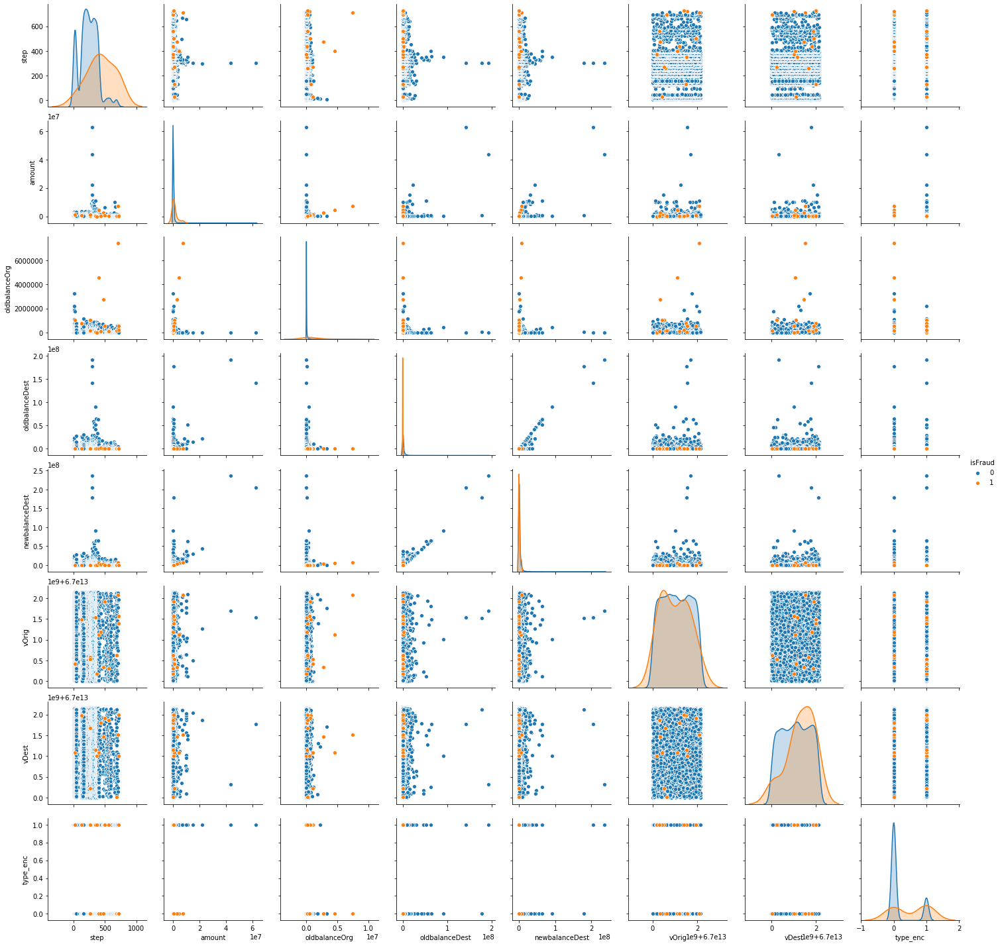

In [53]:
sns.pairplot(sp_pdf, vars= ['step', 'amount', 'oldbalanceOrg', 'oldbalanceDest', 'newbalanceDest', 'vOrig', 'vDest', 'type_enc'], hue='isFraud')

It can be observed a concentration of the frauds on the later point in time (feature step). Not having an information related to the meaning of the feature no informed conclusion can be taken. Furthermore, having only 7 samples within the dataset gives little statistical relevance.

In [59]:
num_columns = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']
sp_pdf[num_columns].iplot(kind='histogram', subplots=True, shape=(3, 2), dimensions=(1280,700))

In [60]:
sp_pdf[sp_pdf.isFraud == 1][num_columns].iplot(kind='histogram', subplots=True, shape=(3, 2), dimensions=(1280,700))

In [55]:
sp_pdf[sp_pdf.isFraud == 1].describe()

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,type_enc,nameOrig_enc,nameDest_enc
count,3.000000,3.000000e+00,3.000000e+00,3.0,3.000000e+00,3.000000e+00,3.0,3.0,3.0,3.000000,3.000000
mean,544.000000,1.308867e+06,1.308867e+06,0.0,1.154054e+06,2.466161e+06,1.0,0.0,1.0,1763.333333,4876.333333
std,207.154532,1.638610e+06,1.638610e+06,0.0,8.903702e+05,2.140607e+06,0.0,0.0,0.0,1955.808102,1220.626615
min,328.000000,3.421206e+05,3.421206e+05,0.0,1.361420e+05,4.879833e+05,1.0,0.0,1.0,524.000000,3469.000000
25%,445.500000,3.628908e+05,3.628908e+05,0.0,8.370243e+05,1.329879e+06,1.0,0.0,1.0,636.000000,4491.000000
50%,563.000000,3.836611e+05,3.836611e+05,0.0,1.537907e+06,2.171774e+06,1.0,0.0,1.0,748.000000,5513.000000
75%,652.000000,1.792240e+06,1.792240e+06,0.0,1.663010e+06,3.455250e+06,1.0,0.0,1.0,2383.000000,5580.000000
max,741.000000,3.200819e+06,3.200819e+06,0.0,1.788113e+06,4.738725e+06,1.0,0.0,1.0,4018.000000,5647.000000


The distribution of the variables is skewed, indicating very low number of transactions with very high amount.

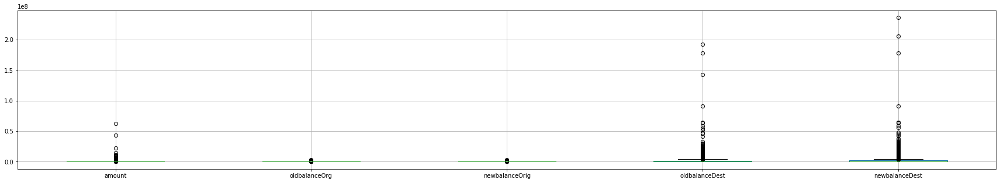

In [66]:
sp_pdf[sp_pdf.isFraud == 0][num_columns].boxplot(figsize=(30,5))

the boxplot of the normal transactions confirm the view presented by the histograms, i.e. a sparse and skewed distribution of the values.

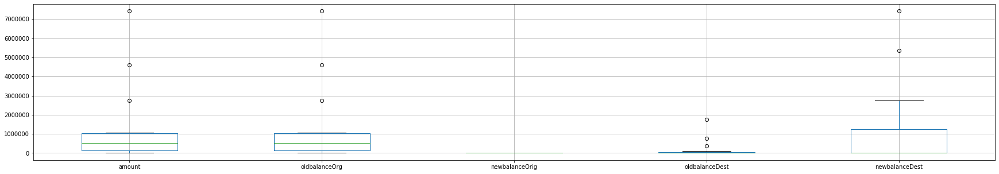

In [65]:
sp_pdf[sp_pdf.isFraud == 1][num_columns].boxplot(figsize=(30,5))

In [67]:
#sp_pdf[sp_pdf.isFraud == 0][num_columns].plot.density()
sp_pdf[sp_pdf.isFraud == 1]

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,vOrig,vDest,type_enc
1744,260,175597.64,175597.64,0.0,376762.66,552360.30,1,67000581522793,67001670620852,0.0
1791,268,1070857.97,1070857.97,0.0,0.00,0.00,1,67000526265092,67000217951439,1.0
3297,26,1027152.36,1027152.36,0.0,0.00,0.00,1,67000414159853,67001087566727,1.0
3811,132,768520.15,768520.15,0.0,0.00,0.00,1,67001484143293,67001982144545,1.0
4288,349,80800.21,80800.21,0.0,0.00,0.00,1,67001531072167,67001150452226,1.0
4646,374,7466.12,7466.12,0.0,0.00,0.00,1,67000186075022,67001001664465,1.0
5049,400,4598089.88,4598089.88,0.0,771511.79,5369601.67,1,67001115133775,67001079679103,0.0
5268,437,119041.12,119041.12,0.0,1755159.60,1874200.73,1,67001186588727,67001803677930,0.0
5282,472,2739869.62,2739869.62,0.0,0.00,2739869.62,1,67000342873826,67001459518542,0.0
5306,499,558136.45,558136.45,0.0,0.00,0.00,1,67001925386760,67001909453139,1.0


In [69]:
corr_columns = [x for x in sp_pdf.columns if x != 'isFlaggedFraud']
sp_corr = sp_pdf[corr_columns].corr('pearson')

#The matrix is displayed as as heat map
sp_corr.style.background_gradient(cmap='coolwarm')

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,vOrig,vDest,type_enc
step,1,0.0385431,0.0149848,-0.040964,0.0363877,0.0387228,0.0722902,0.00783692,0.0191309,0.0247874
amount,0.0385431,1,0.0569612,-0.0303667,0.527357,0.687873,0.0395552,0.0119183,0.0178092,0.25634
oldbalanceOrg,0.0149848,0.0569612,1,0.604606,-0.0179546,-0.00455639,0.38482,0.0123347,0.00216354,-0.00209239
newbalanceOrig,-0.040964,-0.0303667,0.604606,1,-0.0109588,-0.0164484,-0.00893302,0.00745426,-0.00478202,-0.0354042
oldbalanceDest,0.0363877,0.527357,-0.0179546,-0.0109588,1,0.973203,-0.01468,0.0150101,0.0112838,0.0855993
newbalanceDest,0.0387228,0.687873,-0.00455639,-0.0164484,0.973203,1,-0.00694812,0.0155508,0.0146171,0.134058
isFraud,0.0722902,0.0395552,0.38482,-0.00893302,-0.01468,-0.00694812,1,-0.00458791,0.0192541,0.0459479
vOrig,0.00783692,0.0119183,0.0123347,0.00745426,0.0150101,0.0155508,-0.00458791,1,0.00658502,0.000759777
vDest,0.0191309,0.0178092,0.00216354,-0.00478202,0.0112838,0.0146171,0.0192541,0.00658502,1,0.00528812
type_enc,0.0247874,0.25634,-0.00209239,-0.0354042,0.0855993,0.134058,0.0459479,0.000759777,0.00528812,1


oldBalanceOrg and newBalanceOrig as well as oldBalanceDest and newBalanceDest are obviously highly correlated. That does not add any additional information, therefore one feature per pair can be selected

In [66]:
import pandas as pd
from scipy.stats import pearsonr


# This functiona calculates the p-value of the Pearson correlation
# using scipy.stat library
def pearson_corr_pvalue(df):
    df = df.dropna()._get_numeric_data()
    dfcols = pd.DataFrame(columns=df.columns)
    pvalues = dfcols.transpose().join(dfcols, how='outer')
    for r in df.columns:
        for c in df.columns:
            pvalues[r][c] = round(pearsonr(df[r], df[c])[1], 4)
    return pvalues

# This function masks the Pearson correlation matrix marking with 1 star ('*')
# correlation values with p-value <0.1 (bad significance), with 2 stars
# p-value < 0.05 (mid significance), and 3 stars correlations with
# p-value < 0.01 (high significance)
def pearson_corr(df):
    df_corr = round(df.corr(method='pearson'),3)
    pvalues = pearson_corr_pvalue(df)
    
    m_pval_0_10 = df_corr.applymap(lambda x : '{}*'.format(x))
    m_pval_0_05 = df_corr.applymap(lambda x : '{}**'.format(x))
    m_pval_0_01 = df_corr.applymap(lambda x : '{}***'.format(x))
    
    df_corr = df_corr.mask(pvalues<=0.1,m_pval_0_10)
    df_corr = df_corr.mask(pvalues<=0.05,m_pval_0_05)
    df_corr = df_corr.mask(pvalues<=0.01,m_pval_0_01)    
    
    return df_corr

In [67]:
sp_corr2 = pearson_corr(sp_pdf[corr_columns])
sp_corr2

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,type_enc,nameOrig_enc,nameDest_enc
step,1.0***,0.022*,-0.019,-0.019,0.017,0.015,0.046***,-0.004,0.027**,0.016
amount,0.022*,1.0***,-0.01,-0.01,0.308***,0.449***,0.047***,0.329***,-0.016,0.017
oldbalanceOrg,-0.019,-0.01,1.0***,0.999***,0.064***,0.039***,0.004,0.255***,0.002,-0.001
newbalanceOrig,-0.019,-0.01,0.999***,1.0***,0.065***,0.039***,-0.006,0.263***,0.002,-0.001
oldbalanceDest,0.017,0.308***,0.064***,0.065***,1.0***,0.984***,0.001,0.242***,-0.001,0.015
newbalanceDest,0.015,0.449***,0.039***,0.039***,0.984***,1.0***,0.009,0.263***,-0.002,0.017
isFraud,0.046***,0.047***,0.004,-0.006,0.001,0.009,1.0***,-0.001,-0.017,0.02
type_enc,-0.004,0.329***,0.255***,0.263***,0.242***,0.263***,-0.001,1.0***,-0.002,0.004
nameOrig_enc,0.027**,-0.016,0.002,0.002,-0.001,-0.002,-0.017,-0.002,1.0***,0.006
nameDest_enc,0.016,0.017,-0.001,-0.001,0.015,0.017,0.02,0.004,0.006,1.0***


The correlation matrix does not reveal too much. The strong correlation between the newBalanceOrg and newBalanceDest is natural. The isFraud flag does not present any relevant correlation with statistical significance.

In [2]:
spark.stop()